In [1]:
import numpy as np
import cv2 as cv
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import scanpy as sc
import squidpy as sq
import importlib as imp
import seaborn as sns
from tifffile import TiffFile
import umap
import pickle

In [2]:
results_folder = 'results/Xenium/'
# adata_xe = sc.read_10x_h5(filename='F:/Ziqian Zheng/Spatial omics/Xenium/B1/cell_feature_matrix.h5')
adata_xe = sc.read_h5ad('F:/Ziqian Zheng/Spatial omics/Xenium/B1/adata_xe.h5ad')
# y_pred = adata_xe.obs['cell_type']
df = pd.read_csv('F:/Ziqian Zheng/Spatial omics/Xenium/B1/cells.csv')
df.set_index(adata_xe.obs_names, inplace=True)
adata_xe.obs = df.copy()
adata_xe.obsm["spatial"] = adata_xe.obs[["x_centroid", "y_centroid"]].copy().to_numpy()
coordinate_xe = adata_xe.obsm["spatial"]

adata_sc = sc.read_h5ad("F:/Ziqian Zheng/Spotiphy_data/SCRNA/mousebrain/NewMerge_noHarmony.rds.h5ad")
common_gene = list(set(adata_xe.var_names) & set(adata_sc.var_names))
adata_sc = adata_sc[:, common_gene]
adata_xe = adata_xe[:, common_gene]

key_type = 'majortype'
type_list = sorted(list(np.unique(adata_sc.obs[key_type])))
n_type = len(type_list)
adata_xe.uns['type_list'] = type_list

C:\Users\zzheng92\Anaconda3\envs\spotiphy\lib\site-packages\anndata\compat\__init__.py:229: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  warn(


CPU times: total: 5min 27s
Wall time: 9min 35s


<timed exec>:19: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.


In [3]:
X_train = adata_sc.X.toarray()
X_test = adata_xe.X.toarray()
y_train = adata_sc.obs[key_type].to_numpy()
X_train = 1000*X_train/(np.sum(X_train, axis=1, keepdims=True)+1e-8)
X_test = 1000*X_test/(np.sum(X_test, axis=1, keepdims=True)+1e-8)

In [4]:
%%time
from sklearn.ensemble import RandomForestClassifier
clf = RandomForestClassifier(n_estimators=400, random_state=42, n_jobs=16)
np.random.seed(0)
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)
adata_xe.obs['cell_type'] = y_pred
adata_xe.obs['cell_type'].value_counts()

CPU times: total: 8min 53s
Wall time: 37.1 s


cell_type
Oligo          25226
Astro          17390
Microglia       9853
L2/3 IT CTX     7731
Pvalb           4951
CA              4813
Sst             4726
L6 CT CTX       4568
Endo            3683
L4 IT CTX       3519
DG              3129
L4/5 IT CTX     2971
Lamp5           1683
Vip             1647
L5 PT CTX       1592
Sncg            1559
L5/6 IT CTX     1450
L6 IT CTX       1092
L6b CTX         1012
L5/6 NP CTX      790
L5 IT CTX        715
SUB              224
Sst Chodl        214
TCell            176
Macrophage       107
BCell             10
Name: count, dtype: int64

In [5]:
adata_xe_copy = adata_xe.copy()
sc.pp.normalize_per_cell(adata_xe_copy, counts_per_cell_after=1e4)
# sc.pp.log1p(adata_xe_copy)
adata_xe_copy.raw = adata_xe_copy
sc.pp.neighbors(adata_xe_copy, n_pcs = 30, n_neighbors = 20)
sc.tl.umap(adata_xe_copy)

         Falling back to preprocessing with `sc.pp.pca` and default params.


C:\Users\zzheng92\Anaconda3\envs\spotiphy\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


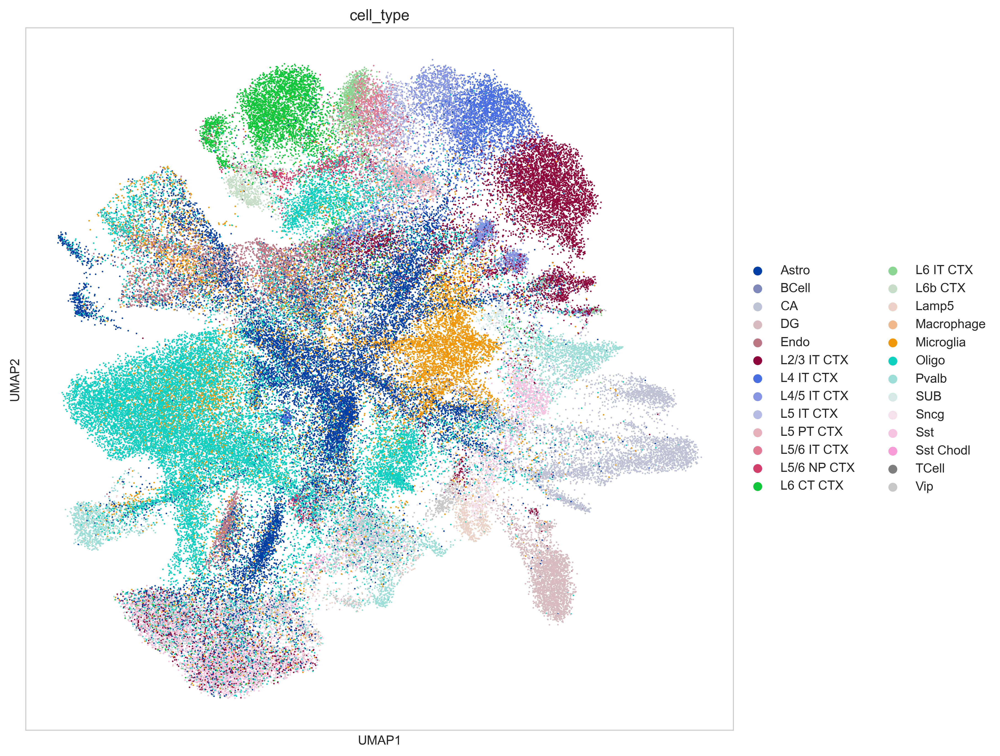

In [6]:
with mpl.rc_context({'figure.figsize': [10, 10], 'figure.dpi': 400}):
    sc.pl.umap(adata_xe_copy, color='cell_type', size=6)

In [7]:
reducer = umap.UMAP()
embedding = reducer.fit_transform(np.log(X_test+1))
embedding_df = pd.DataFrame({'x':embedding[:, 0], 'y':embedding[:, 1], 'cell_type':adata_xe.obs['cell_type']})
embedding.shape

(104831, 2)

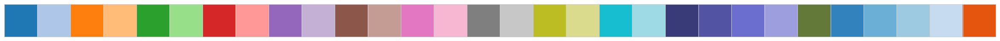

In [4]:
cmap1 = plt.get_cmap("tab20")
cmap2 = plt.get_cmap("tab20b")
cmap3 = plt.get_cmap("tab20c")
colors1 = cmap1.colors
colors2 = cmap2.colors
colors3 = cmap3.colors
contrast_palette = sns.color_palette(list(colors1) + list(colors2[:5]) + list(colors3[:5]))
del cmap1, cmap2, cmap3, colors1, colors2, colors3
sns.palplot(contrast_palette)

In [9]:
# import colorcet as cc
# palette = sns.color_palette(cc.glasbey, n_colors=20)
# sns.palplot(palette)
plt.figure(figsize=(11, 10), dpi=300)
ax = sns.scatterplot(data = embedding_df, x='x', y='y', s=1, hue='cell_type', palette=contrast_palette)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
plt.savefig(results_folder+'umap_xenium_new.jpg', dpi=500, bbox_inches = 'tight')

C:\Users\zzheng92\AppData\Local\Temp\6\ipykernel_14956\2404032812.py:5: UserWarning: The palette list has more values (30) than needed (26), which may not be intended.
  ax = sns.scatterplot(data = embedding_df, x='x', y='y', s=1, hue='cell_type', palette=contrast_palette)


In [6]:
type_list_xe = list(sorted(adata_xe.obs['cell_type'].unique()))
X_test_mean = np.zeros((len(type_list_xe), X_test.shape[1]))
for i, type_ in enumerate(type_list_xe):
    X_test_mean[i] = np.mean(X_test[y_pred==type_], axis=0)
X_test_mean_argmax = np.argmax(X_test_mean, axis=0)
X_test_sort = X_test[np.argsort(y_pred)]
X_test_sort = X_test_sort[:, np.argsort(X_test_mean_argmax)]
X_train_sort = X_train[np.argsort(y_train)]
X_train_sort = X_train_sort[:, np.argsort(X_test_mean_argmax)]

In [12]:
df = pd.DataFrame({'gene':common_gene, 'cell_type':np.array(type_list_xe)[X_test_mean_argmax],
                   'mean_exp':np.max(X_test_mean, axis=0)})
df.to_csv(results_folder+'Xenium_marker.csv')

In [11]:
# fig, ax = plt.subplots(1, 1, figsize=(40, 8), dpi=50)
# palette = sns.cubehelix_palette(n_type, light=.9, dark=.1, reverse=True, start=1, rot=-2)
palette_dict = dict(zip(map(str, type_list), contrast_palette))
col_colors = adata_xe.obs['cell_type'].sort_values().map(palette_dict).to_numpy()
g = sns.clustermap(X_test_sort.T, vmax=40, row_cluster=False, col_cluster=False, xticklabels=False, yticklabels=False,
                   figsize=(16, 10), col_colors=col_colors)
for label in type_list:
    g.ax_col_dendrogram.bar(0, 0, color=palette_dict[label], label=label, linewidth=0)
g.ax_col_dendrogram.legend(loc="center", ncol=6)
g.cax.set_position([.15, .2, .01, .45])
plt.savefig(results_folder+'heatmap_xe.jpg', dpi=500, bbox_inches = 'tight')

In [12]:
adata_sc.obs[key_type] = list(adata_sc.obs[key_type].values)
col_colors = adata_sc.obs[key_type].sort_values().map(palette_dict).to_numpy()
g = sns.clustermap(X_train_sort.T, vmax=40, row_cluster=False, col_cluster=False, xticklabels=False, yticklabels=False,
                   figsize=(16, 10), col_colors=col_colors)
for label in type_list:
    g.ax_col_dendrogram.bar(0, 0, color=palette_dict[label], label=label, linewidth=0)
g.ax_col_dendrogram.legend(loc="center", ncol=6)
g.cax.set_position([.15, .2, .01, .45])
plt.savefig(results_folder+'heatmap_sc.jpg', dpi=500, bbox_inches = 'tight')

C:\Users\zzheng92\AppData\Local\Temp\6\ipykernel_14956\1804680782.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_sc.obs[key_type] = list(adata_sc.obs[key_type].values)


Xenium initial pixel size 0.2125 microns.
Reduce the image size to 1/4. Pizel size 0.85 microns.
Visium pixel size 55/73.06=0.7528 microns.

In [5]:
with TiffFile('F:/Ziqian Zheng/Spatial omics/Xenium/B1/morphology_mip.ome.tif') as tif:
    Xenium = tif.asarray()
del tif
# Initially, the pixel size of Xenium 0.2125 microns.
Xenium = Xenium[::4, ::4]  # Make the size of the image to be 1/4. Now the pixel size is 0.85 microns.

In [6]:
adata_st = sc.read_visium("F:/Ziqian Zheng/Spotiphy_data/ST/Sample221/outs")
adata_st.var_names_make_unique()
adata_st.uns['type_list'] = type_list
coordinate_st = adata_st.obsm["spatial"]
HE = cv.imread('F:/Ziqian Zheng/Spotiphy_data/ST/Sample221/Sample221.jpg')
HE = HE[:, :, [2, 1, 0]]

C:\Users\zzheng92\Anaconda3\envs\spotiphy\lib\site-packages\anndata\_core\anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


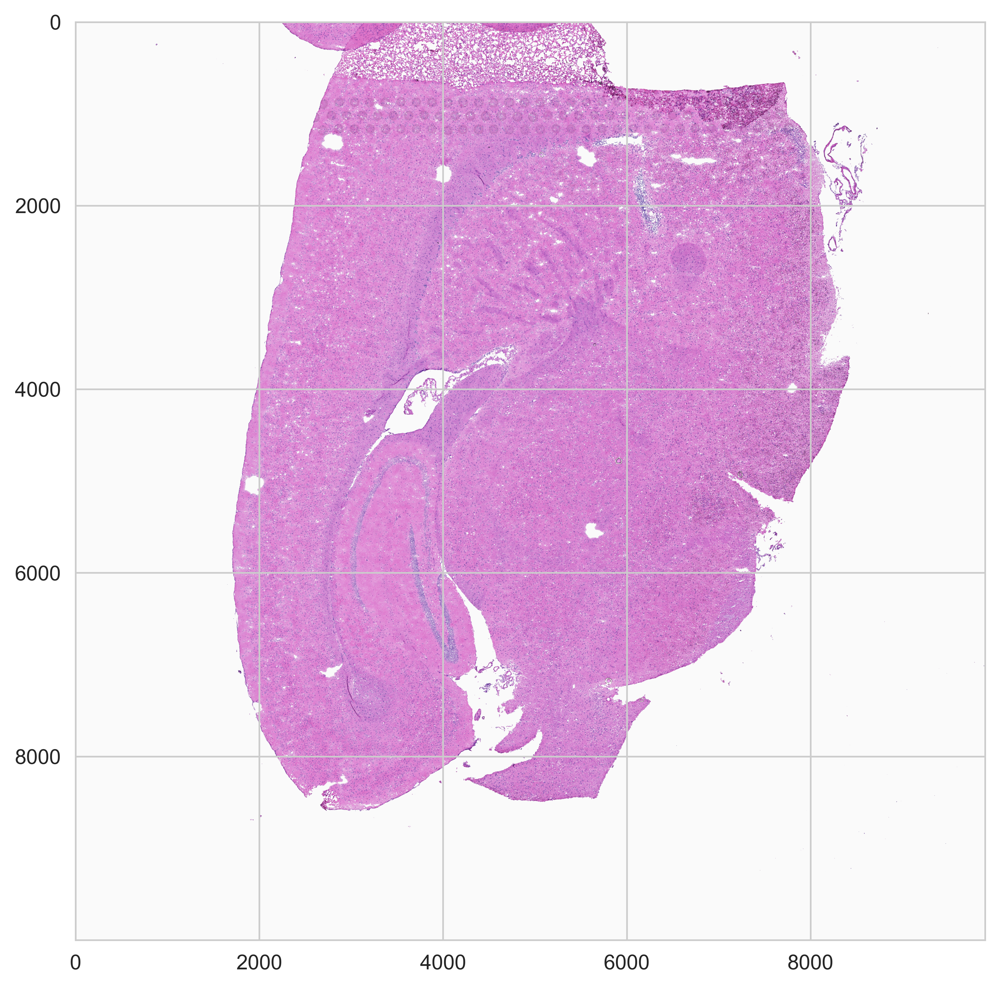

In [7]:
HE_foreground = HE.copy()
HE_foreground[np.max(HE_foreground, axis=2)-np.min(HE_foreground, axis=2)<30] = [250, 250, 250]
plt.figure(figsize=(8, 8), dpi=600)
plt.imshow(HE_foreground)
plt.savefig(results_folder+'HE_foreground.jpg')

In [ ]:
plt.figure(figsize=(8, 8), dpi=600)
plt.imshow(HE)
plt.scatter(coordinate_st[:, 0], coordinate_st[:, 1], s=1)
plt.savefig(results_folder+'HE_spot.jpg')
plt.figure(figsize=(9, 8), dpi=600)
plt.imshow(Xenium)
plt.scatter(coordinate_xe[::10, 0]/0.85, coordinate_xe[::10, 1]/0.85, s=0.1)
# plt.scatter(1000, 4000)
plt.savefig(results_folder+'Xenium_cell.jpg')

In [10]:
# Visium pixel size 0.7528 microns.
Xenium_resize = cv.resize(Xenium, None, fx=0.85/0.7528, fy=0.86*0.86/0.7528, interpolation=cv.INTER_CUBIC)
rows , cols = HE.shape[:2]
theta = 3.39
trans = [7100, 10000]
M = np.float32([[np.cos(theta), -np.sin(theta), trans[0]], [np.sin(theta), np.cos(theta), trans[1]]])
Xenium_resize_Affine = cv.warpAffine(Xenium_resize, M, (cols, rows))
coordinate_xe_resize = coordinate_xe/np.array([[0.7528, 0.7528/0.86]])
coordinate_xe_rotate = coordinate_xe_resize @ M[:, :2].T + trans
adata_xe.obs[['x_centroid', 'y_centroid']] = coordinate_xe_rotate

In [ ]:
from matplotlib.colors import LinearSegmentedColormap
n_colors = np.max(Xenium)
color_array = plt.get_cmap('binary')(range(n_colors))
color_array[:,-1] = np.linspace(0, 2.0, n_colors)
color_array[n_colors//3-1:,-1] = 1
cmap_name = 'binary_alpha'
map_object = LinearSegmentedColormap.from_list(name=cmap_name, colors=color_array)
plt.register_cmap(cmap=map_object, name=cmap_name)
plt.figure(figsize=(10,10), dpi=300)
plt.imshow(HE_foreground, alpha=1)
plt.imshow(Xenium_resize_Affine, alpha=1, cmap=cmap_name)
plt.savefig(results_folder+'Xenium_affine.jpg')

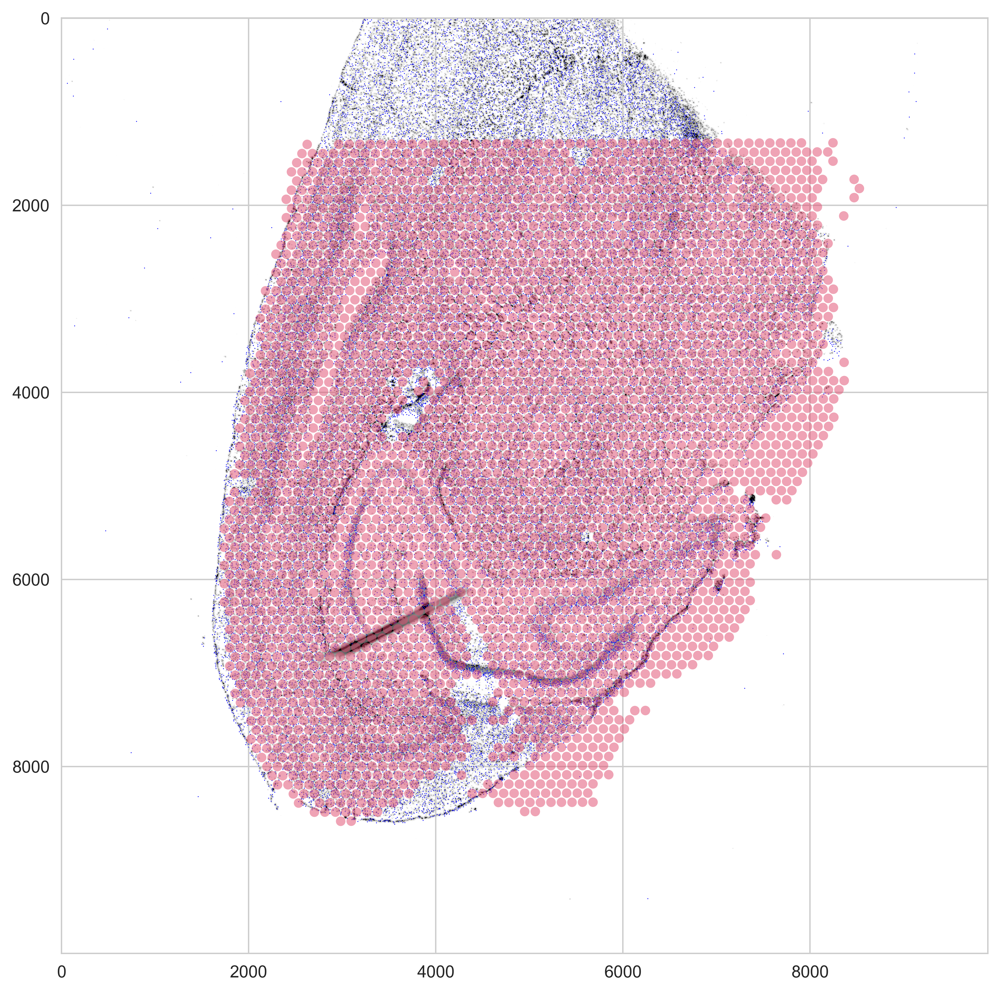

In [12]:
plt.figure(figsize=(10,10), dpi=500)
plt.scatter(coordinate_xe_rotate[::3, 0], coordinate_xe_rotate[::3, 1], s=0.3, edgecolors='None',
            facecolors=(0/250, 0/250, 250/250))
plt.scatter(coordinate_st[:, 0], coordinate_st[:, 1], s=32, alpha=0.5, edgecolors='None',
            facecolors=(220/250, 72/250, 106/250))
plt.imshow(Xenium_resize_Affine, alpha=1, cmap=cmap_name)
plt.savefig(results_folder+'test2.jpg')

In [15]:
distance = np.sum((coordinate_st[:, :, np.newaxis] - coordinate_xe_rotate.T) ** 2, axis=1)
truth_df = pd.DataFrame({type_: [0]*len(adata_st) for type_ in type_list})
truth_df.index = adata_st.obs_names
for i in range(len(adata_st)):
    cell_index = np.where(distance[i] < (2*36.5)**2)[0]
    if len(cell_index) > 0:
        cells = adata_xe.obs['cell_type'].to_numpy()[cell_index]
        for cell in cells:
            truth_df.iloc[i, truth_df.columns.get_loc(cell)] += 1
adata_st.obsm['truth'] = truth_df

In [16]:
row_sum = np.sum(truth_df.to_numpy(), axis=1)
row_sum[row_sum<1] = 1
truth_normalized = truth_df/row_sum[:, np.newaxis]
adata_st.obs[type_list] = truth_df.to_numpy()

In [17]:
Xenium_resize_Affine_copy = Xenium_resize_Affine.copy()
threshold = 1500
Xenium_resize_Affine_copy[Xenium_resize_Affine_copy>threshold] = threshold
Xenium_resize_Affine_copy = threshold - Xenium_resize_Affine_copy
Xenium_resize_Affine_copy = np.clip(Xenium_resize_Affine_copy * (255 / np.max(Xenium_resize_Affine_copy)), 0, 255).astype(np.uint8)
Xenium_background = cv.cvtColor(Xenium_resize_Affine_copy, cv.COLOR_GRAY2RGB)

In [21]:
# type_list_order = ['L2/3 IT CTX', 'L4/5 IT CTX', 'L5 IT CTX', 'L5 PT CTX', 'L5/6 NP CTX', 'L6 CT CTX', 'L6b CTX', 'CAs', 'DG', 'Lamp5',
#                    'Pvalb', 'Sncg', 'Sst', 'Vip', 'Endo', 'Astro', 'Oligo', 'Pericyte', 'Macrophage', 'Microglia', 'Neutrophil',
#                    'TCell', 'BCell']
type_list_order = type_list
adata_st.var.rename(index={'Lamp5': 'Lamp5_g', 'Pvalb': 'Pvalb_g', 'Sst': 'Sst_g', 'Vip': 'Vip_g',
                           'Sncg': 'Sncg_g'}, inplace=True)
adata_st_filtered = adata_st[np.sum(truth_df.to_numpy(), axis=1)>0]
vmax = np.quantile(adata_st_filtered.obs[type_list_order].to_numpy(), 0.98, axis=0)
vmax[vmax < 1] = 1
with mpl.rc_context({'figure.figsize': [5, 5], 'figure.dpi': 400}):
    ax = sc.pl.spatial(adata_st_filtered, cmap='magma', color=type_list_order, vmin=0, vmax=list(vmax), size=1.3, show=False, ncols=7, img=Xenium_background, scale_factor=1)
    ax[0].get_figure().savefig(results_folder+'Xenium_truth.jpg', bbox_inches='tight')

C:\Users\zzheng92\Anaconda3\envs\spotiphy\lib\site-packages\anndata\_core\anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c
C:\Users\zzheng92\Anaconda3\envs\spotiphy\lib\site-packages\anndata\_core\anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c


In [22]:
%matplotlib agg
%matplotlib agg
with mpl.rc_context({'figure.figsize': [5, 5], 'figure.dpi': 800}):
    for i, cell_type in enumerate(type_list):
        ax = sc.pl.spatial(adata_st_filtered, cmap='magma', color=cell_type, vmin=0, vmax=vmax[i], size=1.3,
                           show=False, img=Xenium_background, scale_factor=1)
        cell_type = "".join(x for x in cell_type if x.isalnum())
        ax[0].get_figure().savefig(results_folder+'individual cell number/'+cell_type+'.jpg')

In [25]:
adata_st.obs[type_list] = truth_normalized.to_numpy()
vmax = np.quantile(adata_st_filtered.obs[type_list_order].to_numpy(), 0.98, axis=0)
vmax[vmax < 0.05] = 0.05
with mpl.rc_context({'figure.figsize': [5, 5], 'figure.dpi': 800}):
    for i, cell_type in enumerate(type_list):
        ax = sc.pl.spatial(adata_st_filtered, cmap='magma', color=cell_type, vmin=0, vmax=vmax[i], size=1.3,
                           show=False, img=None, scale_factor=1, img_key=None)
        cell_type = "".join(x for x in cell_type if x.isalnum())
        ax[0].get_figure().savefig(results_folder+'individual proportion nobackground/'+cell_type+'.jpg')

In [27]:
adata_st.write_h5ad(results_folder+'adata_st.h5ad')

In [28]:
adata_xe.write_h5ad('F:/Ziqian Zheng/Spatial omics/Xenium/B1/adata_xe.h5ad')

In [29]:
adata_st.obs['n_cell'] = np.sum(truth_df.to_numpy(), axis=1)
with mpl.rc_context({'figure.figsize': [4, 4.5], 'figure.dpi': 800}):
    ax = sc.pl.spatial(adata_st, cmap='magma', color='n_cell', size=1.3, show=False,
                       img=Xenium_background, scale_factor=1)
    ax[0].get_figure().savefig(results_folder+'n_cell.jpg', bbox_inches='tight')

#### Further analysis

In [69]:
gene_anno = pd.read_excel('results/Xenium_new/Xenium_gene_anno_plan.xlsx', header=None)
gene_anno[2] = gene_anno[2].astype(str)
gene_anno

,0,1,2
0,Acsbg1,Astrocytes,Astro
1,Aqp4,Astrocytes,Astro
2,Cdh20,Astrocytes,Astro
3,Clmn,Astrocytes,Astro
4,Gfap,Astrocytes,Astro
...,...,...,...
243,Penk,Vip interneurons,Vip
244,Pthlh,Vip interneurons,Vip
245,Sorcs3,Vip interneurons,Vip
246,Thsd7a,Vip interneurons,Vip


In [71]:
type_list_anno = sorted(list(gene_anno[2].unique()))
type_list_anno

['Astro',
 'CAs',
 'DG',
 'Endo',
 'L2/3 IT CTX',
 'L4/5 IT CTX',
 'L5 IT CTX',
 'L5 PT CTX',
 'L5/6 NP CTX',
 'L6 CT CTX',
 'L6 IT',
 'L6b CTX',
 'Lamp5',
 'Microglia',
 'Oligo',
 'Pericyte',
 'Pvalb',
 'Sncg',
 'Sst',
 'Vip',
 'nan']

In [76]:
type_gene_dict = {}
for i in range(len(gene_anno)):
    if gene_anno.iloc[i, 0] in adata_xe.var_names:
        if gene_anno.iloc[i, 2] in type_gene_dict:
            type_gene_dict[gene_anno.iloc[i, 2]] += [adata_xe.var_names.get_loc(gene_anno.iloc[i, 0])]
        else:
            type_gene_dict[gene_anno.iloc[i, 2]] = [adata_xe.var_names.get_loc(gene_anno.iloc[i, 0])]
for key in type_gene_dict.keys():
    type_gene_dict[key] = np.array(type_gene_dict[key])

In [80]:
expression_marker = np.zeros((len(adata_st), len(type_list_anno)))
X = adata_xe.X.toarray()
for i in range(len(adata_st)):
    cell_index = np.where(distance[i] < 36.5**2)[0]
    if len(cell_index) > 0:
        expression_temp = np.array(X[cell_index])
        for j, type_ in enumerate(type_list_anno):
            if np.ndim(expression_temp) > 1:
                expression_marker[i, j] = np.sum(np.mean(expression_temp[:, type_gene_dict[type_]], axis=1))
            else:
                expression_marker[i, j] = np.mean(expression_temp[type_gene_dict[type_]])

In [81]:
adata_st.obs[type_list_anno] = expression_marker
with mpl.rc_context({'figure.figsize': [5, 5], 'figure.dpi': 400}):
    ax = sc.pl.spatial(adata_st, cmap='magma', color=type_list_anno, vmin=0, vmax='p99.8', size=1.3, show=False, ncols=5, img=Xenium_background, scale_factor=1)
    ax[0].get_figure().savefig('results/Xenium_new/marker_gene.jpg', bbox_inches='tight')